In [15]:
#import data from sklearn.datasets
import pandas as pd
from sklearn import datasets
from sklearn.model_selection import train_test_split
dataset = datasets.load_breast_cancer()
class_names = dataset.target_names
X = dataset['data']
# X = pd.DataFrame(dataset['data'])

K= 2 , Silhouette = 0.6972646156059464
K= 3 , Silhouette = 0.6660201620263426
K= 4 , Silhouette = 0.5334614737117133
K= 5 , Silhouette = 0.5102292997907839
K= 6 , Silhouette = 0.4816190180994734
K= 7 , Silhouette = 0.4670113889173129
K= 8 , Silhouette = 0.4673838701211962
K= 9 , Silhouette = 0.4614195833060586
K= 10 , Silhouette = 0.4660464752161599


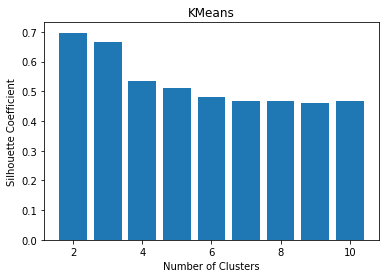

In [16]:
#kmeans
from sklearn.cluster import KMeans
from sklearn import metrics
import matplotlib.pyplot as plt
#以 Silhouette Coefficient 選擇分群數
silhouette_avgs = []
ks = range(2, 11)
for k in ks:
    kmeans_fit = KMeans(n_clusters = k).fit(X)
    cluster_labels = kmeans_fit.labels_
    silhouette_avg = metrics.silhouette_score(X, cluster_labels)
    silhouette_avgs.append(silhouette_avg)

#印出 Silhouette Coefficient 並作圖
for k in ks:
    print('K=', k, ', Silhouette =', silhouette_avgs[k-2])

plt.bar(ks, silhouette_avgs)
plt.ylabel('Silhouette Coefficient')
plt.xlabel('Number of Clusters')
plt.title('KMeans')
plt.show()

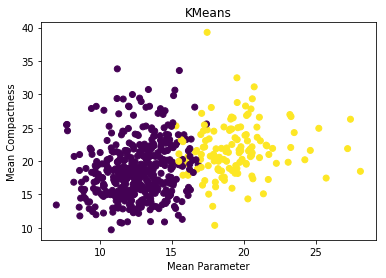

In [17]:
# 選擇 k=2 作圖

kmeans_fit = KMeans(n_clusters = 2).fit(X)
labels = kmeans_fit.labels_

# 投影至其中兩個維度

plt.scatter(X[:, 0], X[:, 1], c=labels, cmap='viridis')
plt.ylabel('Mean Compactness')
plt.xlabel('Mean Parameter')
plt.title('KMeans')
plt.show()

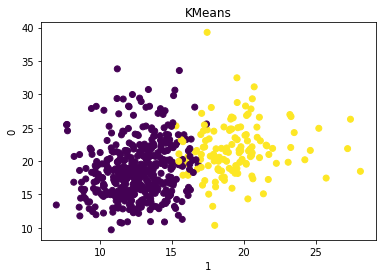

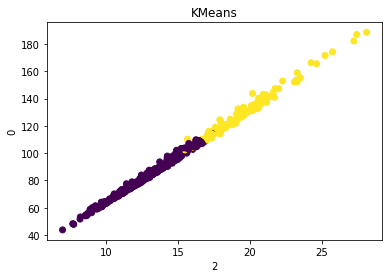

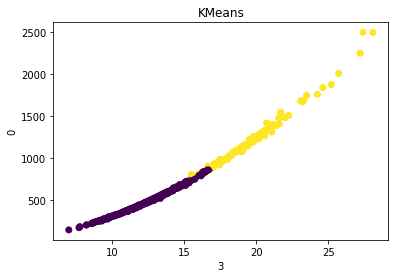

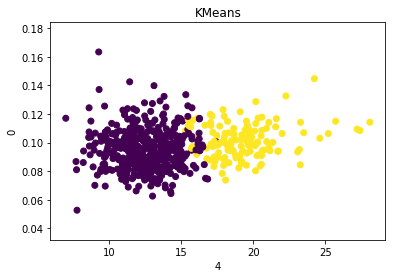

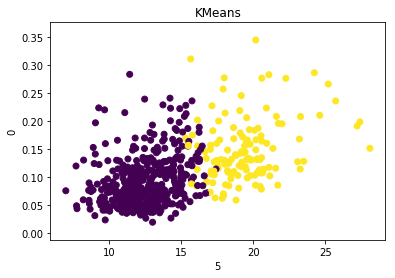

...

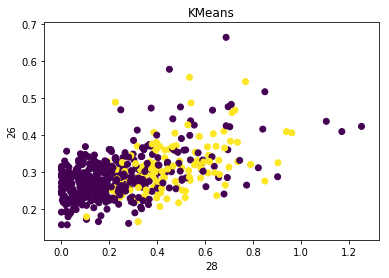

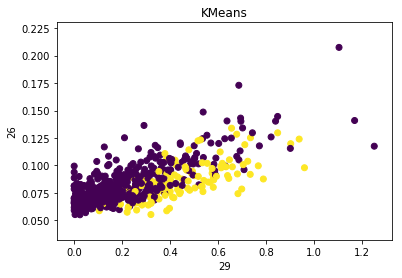

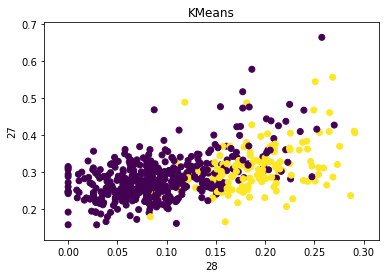

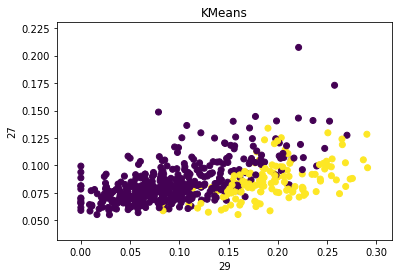

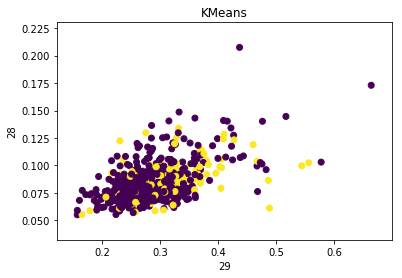

In [18]:
for i in range(30):
    for j in range(30):
        if i!=j and i<j:
            plt.scatter(X[:, i], X[:, j], c=labels, cmap='viridis')
            plt.ylabel(i)
            plt.xlabel(j)
            plt.title('KMeans')
            plt.show()

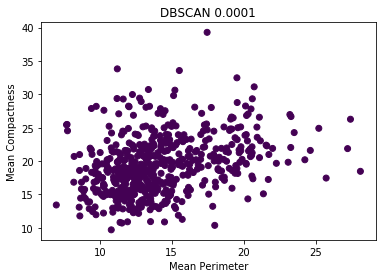

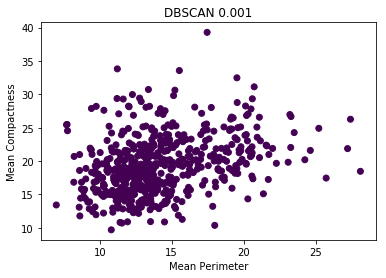

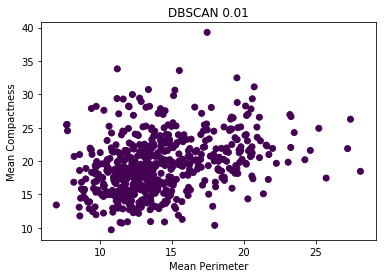

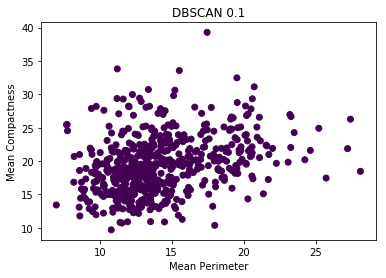

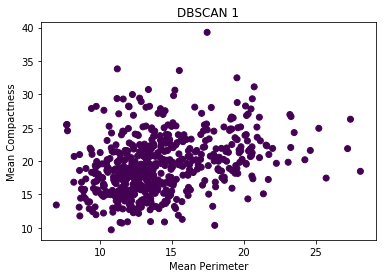

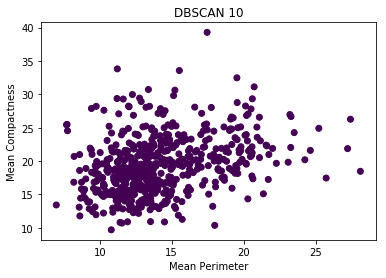

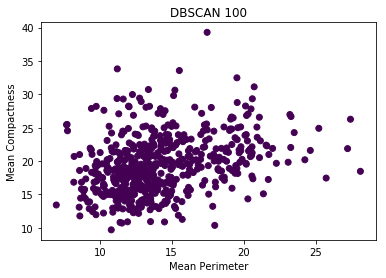

In [25]:
#DBSCAN
import pandas as pd
from sklearn.cluster import DBSCAN
from sklearn import metrics
import matplotlib.pyplot as plt
#transform dataset to dataframe
X = pd.DataFrame(dataset['data'])
#以 Silhouette Coefficient 選擇兩點距離k
silhouette_avgs = []
ks = range(-4, 3)
for k in ks:
    clustering = DBSCAN(eps=pow(10, k), min_samples=10).fit(X)
    y_pred = DBSCAN().fit_predict(X)
    plt.scatter(X.values[:,0], X.values[:,1], c=y_pred, cmap='viridis')
    plt.ylabel('Mean Compactness')
    plt.xlabel('Mean Perimeter')
    plt.title('DBSCAN '+str(pow(10,k)))
    plt.show()

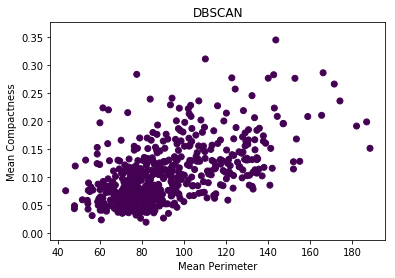

In [20]:
#選擇 k=2
clustering = DBSCAN(eps=2, min_samples=10).fit(X)
y_pred = DBSCAN().fit_predict(X)
#投影至其中兩個維度
plt.scatter(X.values[:,2], X.values[:,5], c=y_pred, cmap='viridis')
plt.ylabel('Mean Compactness')
plt.xlabel('Mean Perimeter')
plt.title('DBSCAN')
plt.show()

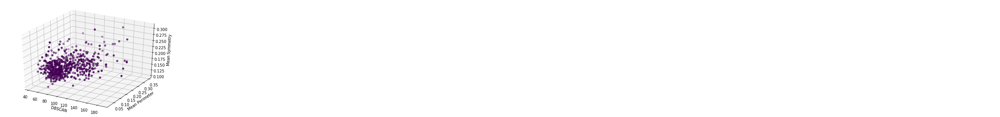

In [21]:
#投影至其中三個維度
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D
fig = pyplot.figure()
ax = Axes3D(fig)
ax.scatter(X.values[:,2], X.values[:,5], X.values[:,8], c=y_pred, cmap='viridis')
ax.set_xlabel('Mean Compactness')
ax.set_ylabel('Mean Perimeter')
ax.set_zlabel('Mean Symmetry')
ax.set_xlabel('DBSCAN')
pyplot.show()

In [22]:
#description of each cluster
for i in range(0,2):
    print('### Clustering',i+1,'###\n',X[labels == i].describe(),'\n')

### Clustering 1 ###
                0           1           2           3           4           5   \
count  438.000000  438.000000  438.000000  438.000000  438.000000  438.000000   
mean    12.556299   18.570365   81.123470  496.061872    0.094884    0.091100   
std      1.912698    4.146210   13.033478  148.766651    0.014392    0.044198   
min      6.981000    9.710000   43.790000  143.500000    0.052630    0.019380   
25%     11.322500   15.662500   73.005000  394.100000    0.084520    0.059087   
50%     12.600000   18.150000   81.320000  487.400000    0.094140    0.079455   
75%     13.857500   20.935000   89.765000  593.425000    0.103900    0.113875   
max     17.420000   33.810000  114.500000  948.000000    0.163400    0.283900   

               6           7           8           9      ...              20  \
count  438.000000  438.000000  438.000000  438.000000     ...      438.000000   
mean     0.062438    0.033433    0.178058    0.063454     ...       14.043902   
std  

K= 2 , Silhouette = 0.5315172918032405
K= 3 , Silhouette = 0.5118243327922464
K= 4 , Silhouette = 0.49691775183341197
K= 5 , Silhouette = 0.42077095612269905
K= 6 , Silhouette = 0.42669396717856234
K= 7 , Silhouette = 0.4111163531251019
K= 8 , Silhouette = 0.3929633240782386
K= 9 , Silhouette = 0.3927144683552633
K= 10 , Silhouette = 0.41090654991986497


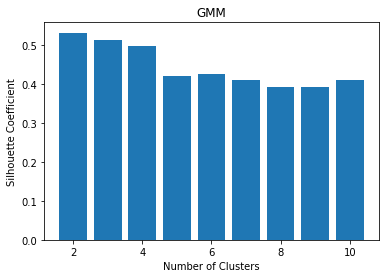

In [23]:
#GMM
from sklearn.mixture import GaussianMixture
from sklearn import metrics
import matplotlib.pyplot as plt
#以 Silhouette Coefficient 選擇分群數
silhouette_avgs = []
ks = range(2, 11)
for k in ks:
    gmm = GaussianMixture(n_components=k).fit(X)
    labels = gmm.predict(X)
    silhouette_avg = metrics.silhouette_score(X, labels)
    silhouette_avgs.append(silhouette_avg)

#作圖並印出 K = 2~10 的 Silhouette Coefficient
for k in ks:
    print('K=', k, ', Silhouette =', silhouette_avgs[k-2])

plt.bar(ks, silhouette_avgs)
plt.ylabel('Silhouette Coefficient')
plt.xlabel('Number of Clusters')
plt.title('GMM')
plt.show()

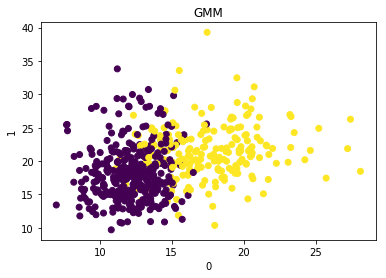

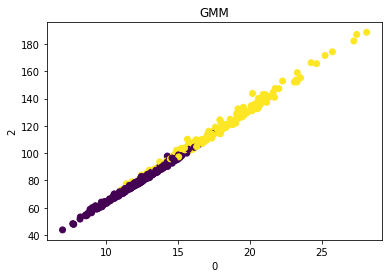

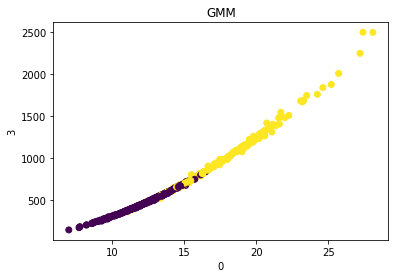

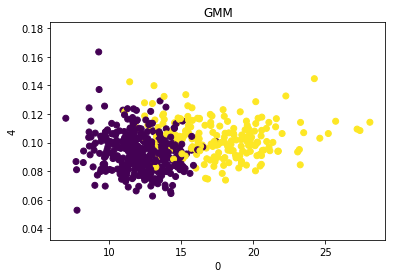

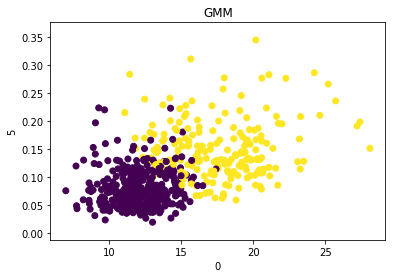

...

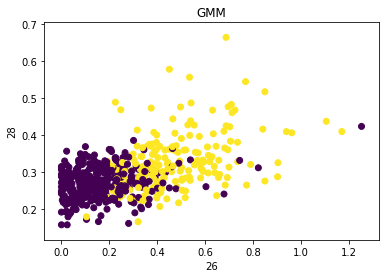

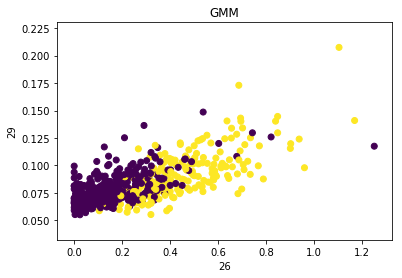

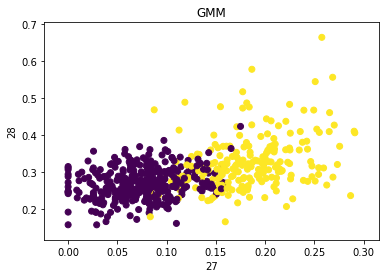

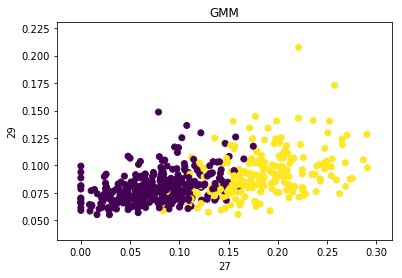

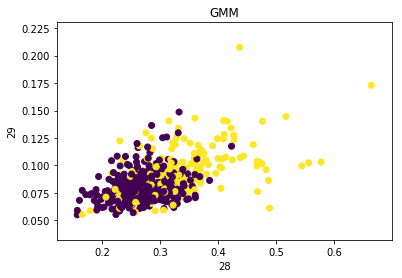

In [24]:
#選擇 k=2
gmm = GaussianMixture(n_components=2).fit(X)
labels = gmm.predict(X)
#投影至其中兩個維度
for i in range(0,29):
    for j in range(i+1,30):
            plt.scatter(X.values[:,i], X.values[:,j], c=labels, cmap='viridis')
            plt.ylabel(j)
            plt.xlabel(i)
            plt.title('GMM')
            plt.show()